In [1]:

import numpy as np
import matplotlib.pyplot as plt

from lava.lib.dl.slayer import obd

#import ipyplot
from matplotlib import animation
import IPython.display as ipd

## Prophesee's Automotive dataset

In [2]:
root = '/home/lecampos/lava-dev/data/prophesee'
train_set = obd.dataset.PropheseeAutomotive(root=root, train=True, seq_len=10000, randomize_seq=False, augment_prob=1.0)

In [3]:
print(f'{len(train_set) = }')

len(train_set) = 49


In [4]:
print(f'{train_set.classes = }')
print(f'{train_set.idx_map = }')

train_set.classes = ['pedestrian', 'two wheeler', 'car', 'truck', 'bus', 'traffic sign', 'traffic light']
train_set.idx_map = {0: 'pedestrian', 1: 'two wheeler', 2: 'car', 3: 'truck', 4: 'bus', 5: 'traffic sign', 6: 'traffic light'}


In [5]:
idx = np.random.randint(len(train_set))
image, annotation = train_set[idx]
to_display = []
for idx in range(image.shape[-1]):
    test = image[:,:,:,idx]
    to_display.append(obd.bbox.utils.mark_bounding_boxes(obd.bbox.utils.render_events_img(image[:,:,:,idx]),
                                          annotation[idx]['annotation']['object'],
                                          thickness=1))

# ipyplot.plot_images(to_display, max_images=5, img_width=448)
fig, ax = plt.subplots(figsize=(5, 5))
img_plt = ax.imshow(to_display[0])
ax.axis('off')

def animate(i):
    img_plt.set_data(to_display[i])

anim = animation.FuncAnimation(fig, animate, frames=len(to_display), interval=40, repeat=True)
plt.close(fig)
ipd.HTML(anim.to_jshtml())

Animation size has reached 21053725 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [6]:
# Test annotation_from_tensor and tensor_from_annotation
tensor = obd.bbox.utils.tensor_from_annotation(annotation[0])
new_ann = obd.bbox.utils.annotation_from_tensor(
    tensor,
    frame_size=annotation[0]['annotation']['size'],
    object_names=train_set.classes)
print(annotation[0]['annotation']['size'])

{'height': 448.0, 'width': 448.0}


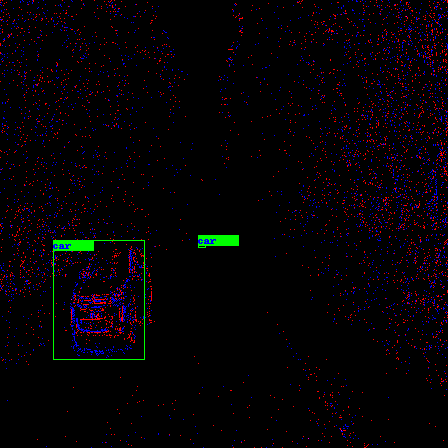

In [7]:
display(obd.bbox.utils.mark_bounding_boxes(
    obd.bbox.utils.render_events_img(image[:, :, :, 0]),
    annotation[0]['annotation']['object'],
    thickness=1))